## Clustering ArXiv open source papers

In [4]:
from datasets import load_dataset

dataset = load_dataset("maartengr/arxiv_nlp")["train"]
# metadata
abstracts = dataset["Abstracts"]
titles = dataset["Titles"]

In [5]:
from sentence_transformers import SentenceTransformer

embedding_model = SentenceTransformer("avsolatorio/GIST-small-Embedding-v0")
embeddings = embedding_model.encode(abstracts, show_progress_bar=True)

Batches:   0%|          | 0/1405 [00:00<?, ?it/s]

In [3]:
embeddings.shape

(44949, 384)

In [10]:
!pip install "umap-learn"

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.6/2.6 MB 22.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 28.8/28.8 MB 42.7 MB/s eta 0:00:00a 0:00:01

[notice] A new release of pip is available: 24.2 -> 24.3.1
[notice] To update, run: pip install --upgrade pip


In [7]:
from umap import UMAP

umap_model = UMAP(
    n_components=5, min_dist=0.0, metric='cosine', random_state=42
)
reduce_embeddings = umap_model.fit_transform(embeddings)

/Users/mathias/Documents/research2025/LLMs/.venv/lib/python3.11/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/mathias/Documents/research2025/LLMs/.venv/lib/python3.11/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


In [8]:
!pip install hdbscan

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.5/1.5 MB 15.0 MB/s eta 0:00:00

[notice] A new release of pip is available: 24.2 -> 24.3.1
[notice] To update, run: pip install --upgrade pip


### creating clusters from our data

In [12]:
from hdbscan import HDBSCAN

hdbscan_model = HDBSCAN(
    min_cluster_size=50, metric="euclidean", cluster_selection_method="eom"
).fit(reduce_embeddings)
clusters = hdbscan_model.labels_
len(set(clusters))

/Users/mathias/Documents/research2025/LLMs/.venv/lib/python3.11/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/mathias/Documents/research2025/LLMs/.venv/lib/python3.11/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


152

### inspecting our clusters

In [21]:
import numpy as np

cluster = 0
for index in np.where(clusters==clusters)[0][5:8]:
    print(abstracts[index][:300] + "... \n")

  This paper describes the Linguistic Annotation Framework under development
within ISO TC37 SC4 WG1. The Linguistic Annotation Framework is intended to
serve as a basis for harmonizing existing language resources as well as
developing new ones.
... 

  We show that a general model of lexical information conforms to an abstract
model that reflects the hierarchy of information found in a typical dictionary
entry. We show that this model can be mapped into a well-formed XML document,
and how the XSL transformation language can be used to implement ... 

  This research hypothesized that a practical approach in the form of a
solution framework known as Natural Language Understanding and Reasoning for
Intelligence (NaLURI), which combines full-discourse natural language
understanding, powerful representation formalism capable of exploiting
ontologica... 



In [23]:
import pandas as pd

reduced_embeddings = UMAP(
    n_components=2, min_dist=0.0, metric="cosine", random_state=42
).fit_transform(embeddings)

df = pd.DataFrame(reduced_embeddings, columns=["x", "y"])
df["title"] = titles
df["cluster"] = [str(c) for c in clusters]

to_plot = df.loc[df.cluster != "-1", :]
outliers = df.loc[df.cluster == "-1", :]

/Users/mathias/Documents/research2025/LLMs/.venv/lib/python3.11/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/mathias/Documents/research2025/LLMs/.venv/lib/python3.11/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


##### Any dimensionality reduction technique for visualizationpurposes creates information loss. It is merely an approximation

(-6.911891007423401,
 12.231474423408509,
 -5.566774511337281,
 12.478593015670777)

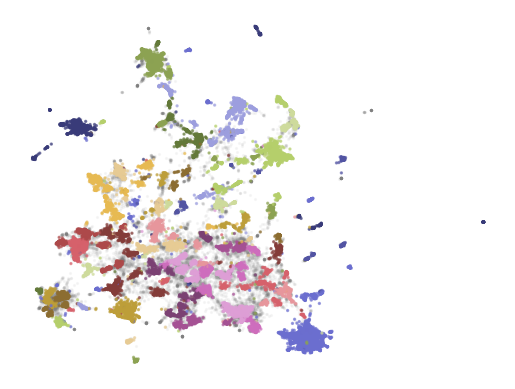

In [24]:
import matplotlib.pyplot as plt

plt.scatter(outliers.x, outliers.y, alpha=0.05, s=2, c="grey")
plt.scatter(
    to_plot.x, to_plot.y, c=to_plot.cluster.astype(int), alpha=0.6, s=2, cmap="tab20b"
)
plt.axis("off")

In [25]:
!pip install bertopic

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 19.1/19.1 MB 15.8 MB/s eta 0:00:0000:0100:01

[notice] A new release of pip is available: 24.2 -> 24.3.1
[notice] To update, run: pip install --upgrade pip


### Topic modeling

In [26]:
from bertopic import BERTopic

topic_model = BERTopic(
    embedding_model=embedding_model,
    umap_model=umap_model,
    hdbscan_model=hdbscan_model,
    verbose=True
).fit(abstracts, embeddings)

topic_model.get_topic_info()

2025-01-12 09:38:19,866 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
2025-01-12 09:38:50,496 - BERTopic - Dimensionality - Completed ✓
2025-01-12 09:38:50,497 - BERTopic - Cluster - Start clustering the reduced embeddings
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been us

,Topic,Count,Name,Representation,Representative_Docs
0,-1,13967,-1_of_the_and_to,"[of, the, and, to, in, we, that, for, language...",[ The dominating NLP paradigm of training a s...
1,0,2471,0_speech_asr_recognition_end,"[speech, asr, recognition, end, acoustic, audi...",[ This paper presents a method to train end-t...
2,1,1325,1_medical_clinical_biomedical_patient,"[medical, clinical, biomedical, patient, notes...",[ Pre-training large-scale neural language mo...
3,2,1222,2_sentiment_aspect_analysis_reviews,"[sentiment, aspect, analysis, reviews, opinion...","[ Text sentiment analysis, also known as opin..."
4,3,1190,3_summarization_summaries_summary_abstractive,"[summarization, summaries, summary, abstractiv...",[ Abstractive text summarization aims at comp...
...,...,...,...,...,...
147,146,53,146_wikipedia_articles_article_web,"[wikipedia, articles, article, web, editors, d...","[ Lack of encyclopedic text contributors, esp..."
148,147,53,147_product_attribute_commerce_values,"[product, attribute, commerce, values, product...",[ Product offers on e-commerce websites often...
149,148,53,148_indian_translation_hindi_smt,"[indian, translation, hindi, smt, machine, eng...",[ We present in this paper our work on compar...
150,149,52,149_job_resume_skill_skills,"[job, resume, skill, skills, resumes, market, ...",[ A reliable resume-job matching system helps...


In [27]:
topic_model.get_topic(0)

[('speech', 0.028450989916682566),
 ('asr', 0.01828007977345783),
 ('recognition', 0.013293049150060021),
 ('end', 0.009977523829259434),
 ('acoustic', 0.009315434451023367),
 ('audio', 0.0071456476535288575),
 ('speaker', 0.0066019708253929115),
 ('spoken', 0.006461685737431407),
 ('the', 0.006432568592140621),
 ('to', 0.006329868742694655)]

In [28]:
# find based on search term
topic_model.find_topics("sentiment")

([52, 2, 85, 143, 26],
 [0.8406512, 0.8387044, 0.7927139, 0.78927374, 0.78441095])

In [29]:
topic_model.get_topic(52)

[('emotion', 0.06959007659501654),
 ('emotions', 0.03337275994251147),
 ('emotional', 0.01244049254655278),
 ('anger', 0.010086851605380448),
 ('affective', 0.009673852131105266),
 ('intensity', 0.00890353198216071),
 ('appraisal', 0.008155693672270816),
 ('arousal', 0.007885174860620977),
 ('valence', 0.007440026180689377),
 ('classification', 0.006858765162935237)]

In [46]:
# 52_emotion_emotions_emotional_anger
topic_model.get_topic_info()[53:54]

,Topic,Count,Name,Representation,Representative_Docs
53,52,179,52_emotion_emotions_emotional_anger,"[emotion, emotions, emotional, anger, affectiv...","[ In this paper, we propose a new framework f..."


In [55]:
fig = topic_model.visualize_documents(
    titles,
    reduced_embeddings=reduced_embeddings,
    width=1200,
    hide_annotations=True
)
fig.update_layout(font=dict(size=16))
fig.write_html("bert_visualization.html")

In [56]:
from IPython.display import HTML

HTML(filename="bert_visualization.html")

In [62]:
bar_chart = topic_model.visualize_barchart()
bar_chart.write_html("bert_bar_visualization.html")

In [63]:
HTML(filename="bert_bar_visualization.html")

In [64]:
heat_map = topic_model.visualize_heatmap(n_clusters=30)
heat_map.write_html("bert_heat_visualization.html")

In [65]:
HTML(filename="bert_heat_visualization.html")

In [66]:
hierarchy = topic_model.visualize_hierarchy()
hierarchy.write_html("bert_hierarchy_visualization.html")

In [67]:
HTML(filename="bert_hierarchy_visualization.html")

In [70]:
from copy import deepcopy

original_topics = deepcopy(topic_model.topic_representations_)
def topic_differences(model, original_topics, nr_topics=5):
    """differences in topic representations between models"""
    df = pd.DataFrame(columns=["Topic", "Original", "Updated"])
    for topic in range(nr_topics):
        # top 5 words per topic per model
        og_words = " | ".join(list(zip(*original_topics[topic]))[0][:5])
        new_words = " | ".join(list(zip(*model.get_topic(topic)))[0][:5])
        df.loc[len(df)] = [topic, og_words, new_words]
    return df

In [72]:
from bertopic.representation import KeyBERTInspired

# KeyBERTInspired removes nearly all top words focuses on semantic relationships
representation_model = KeyBERTInspired()
topic_model.update_topics(abstracts, representation_model=representation_model)

topic_differences(topic_model, original_topics)

,Topic,Original,Updated
0,0,speech | asr | recognition | end | acoustic,voice | phonetic | encoder | speech | language
1,1,medical | clinical | biomedical | patient | notes,nlp | ehr | ehrs | clinical | medicine
2,2,sentiment | aspect | analysis | reviews | opinion,sentiment | sentiments | aspect | words | anal...
3,3,summarization | summaries | summary | abstract...,summarization | summarizing | summaries | task...
4,4,hate | offensive | detection | speech | social,hateful | hate | cyberbullying | offensive | l...


In [73]:
## MMR technique reduces redundant keywords (Maximal Marginal Relevance)
from bertopic.representation import MaximalMarginalRelevance

representation_model = MaximalMarginalRelevance(diversity=0.2)
topic_model.update_topics(abstracts, representation_model=representation_model)

topic_differences(topic_model, original_topics)

,Topic,Original,Updated
0,0,speech | asr | recognition | end | acoustic,speech | asr | recognition | audio | model
1,1,medical | clinical | biomedical | patient | notes,medical | clinical | biomedical | patient | he...
2,2,sentiment | aspect | analysis | reviews | opinion,sentiment | aspect | analysis | reviews | absa
3,3,summarization | summaries | summary | abstract...,summarization | summaries | abstractive | eval...
4,4,hate | offensive | detection | speech | social,hate | offensive | toxic | toxicity | abusive


In [76]:
from transformers import pipeline
from bertopic.representation import TextGeneration

prompt = """I have a topic that contains the following documents:
[DOCUMENTS]

the topic is described by the following keywords: '[KEYWORDS]'.

Based on the documents and keywords, what is this topic about?"""

generator = pipeline("text2text-generation", model="google/flan-t5-small")
representation_model = TextGeneration(
    generator, prompt=prompt, doc_length=50, tokenizer="whitespace"
)
topic_model.update_topics(abstracts, representation_model=representation_model)
topic_differences(topic_model, original_topics)

Device set to use mps:0
100%|█████████████████████████████████████████████████████████| 152/152 [01:35<00:00,  1.59it/s]


,Topic,Original,Updated
0,0,speech | asr | recognition | end | acoustic,Speech-to-speech synthesis | | | |
1,1,medical | clinical | biomedical | patient | notes,Science/Tech | | | |
2,2,sentiment | aspect | analysis | reviews | opinion,Sentiment analysis | | | |
3,3,summarization | summaries | summary | abstract...,Summarization of text documents | | | |
4,4,hate | offensive | detection | speech | social,Hate Speech | | | |


In [7]:
!pip install --upgrade bertopic openai

  Using cached openai-1.59.6-py3-none-any.whl.metadata (27 kB)
Using cached openai-1.59.6-py3-none-any.whl (454 kB)
  Attempting uninstall: openai
    Found existing installation: openai 0.28.0
    Uninstalling openai-0.28.0:
      Successfully uninstalled openai-0.28.0

[notice] A new release of pip is available: 24.2 -> 24.3.1
[notice] To update, run: pip install --upgrade pip


## Next two cells needed an OpenAI subscription

In [4]:
from bertopic.representation import OpenAI
import openai

prompt = """I have a topic that contains the following documents:
[DOCUMENTS]

the topic is described by the following keywords: [KEYWORDS]

Based on the information above, extract a short topic label in the following format:
topic: <short topic label>
"""
client = openai.OpenAI(api_key="redacted")
representation_model = OpenAI(
    client, model="gpt-3.5-turbo", exponential_backoff=True, chat=True, prompt=prompt
)
topic_model.update_topics(abstracts, representation_model=representation_model)
topic_differences(topic_model, original_topics)

NameError: name 'topic_model' is not defined

In [5]:
fig = topic_model.visualize_document_datamap(
    titles,
    topics=list(range(20)),
    reduced_embeddings=reduced_embeddings,
    width=1200,
    label_font_size=11,
    label_wrap_width=20,
    use_medoids=True,
)
fig.write_html("gpt_topic_visualization.html")
HTML(filename="gpt_topic_visualization.html")

NameError: name 'topic_model' is not defined